## Setup

In [1]:
import torch.optim as optim
import torch
import torch.nn as nn
from torchvision import models

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
!unzip '/content/drive/MyDrive/classification_dataset.zip' -d '/content'

Streaming output truncated to the last 5000 lines.
  inflating: /content/classification_dataset/images/2015_65471.jpg  
  inflating: /content/__MACOSX/classification_dataset/images/._2015_65471.jpg  
  inflating: /content/classification_dataset/images/2022_16185.jpg  
  inflating: /content/__MACOSX/classification_dataset/images/._2022_16185.jpg  
  inflating: /content/classification_dataset/images/2015_48285.jpg  
  inflating: /content/__MACOSX/classification_dataset/images/._2015_48285.jpg  
  inflating: /content/classification_dataset/images/2015_2476.jpg  
  inflating: /content/__MACOSX/classification_dataset/images/._2015_2476.jpg  
  inflating: /content/classification_dataset/images/2022_20423.jpg  
  inflating: /content/__MACOSX/classification_dataset/images/._2022_20423.jpg  
  inflating: /content/classification_dataset/images/2022_1112.jpg  
  inflating: /content/__MACOSX/classification_dataset/images/._2022_1112.jpg  
  inflating: /content/classification_dataset/images/2015_12

In [4]:
import pandas as pd
import os

labels_df = pd.read_csv(
    os.path.join('classification_dataset', 'labels.txt'),
    sep=' ',
    names=['filename', 'label']  )

In [5]:
labels_df.head()

,filename,label
0,2022_13843.jpg,Eel
1,2022_498.jpg,Eel
2,2022_2147.jpg,Eel
3,2022_3003.jpg,Eel
4,2022_2694.jpg,Eel


## Preprocessing

In [6]:
from sklearn.model_selection import train_test_split

train_df, val_df = train_test_split(labels_df, test_size=0.2, stratify=labels_df['label'], random_state=42)
print(len(train_df), len(val_df))

8400 2100


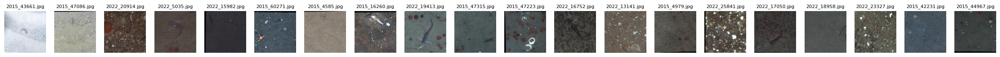

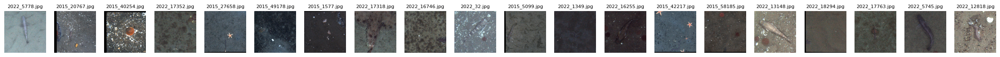

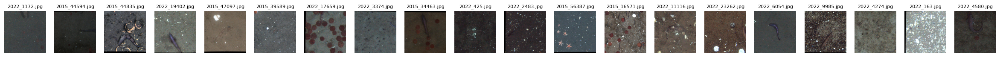

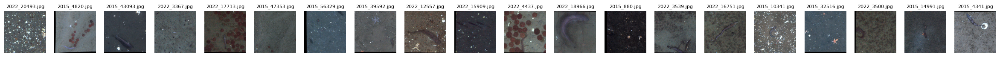

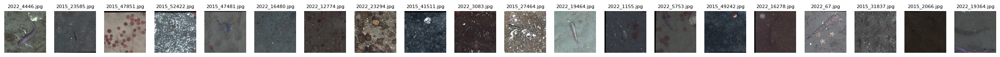

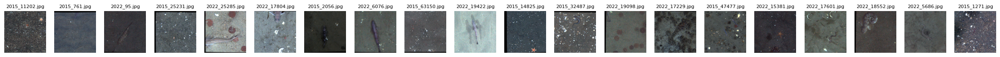

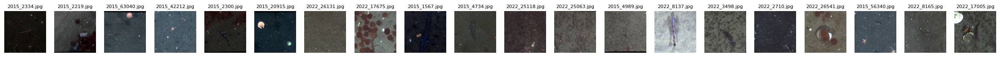

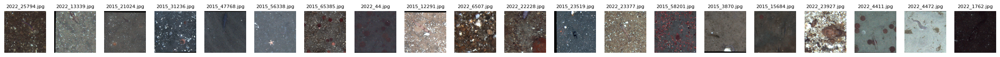

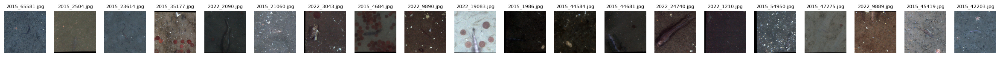

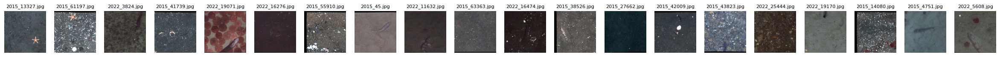

In [15]:
import matplotlib.pyplot as plt
from PIL import Image
roundfish = val_df[val_df['label']=='roundfish']
img_col='filename'
image_folder='classification_dataset/images'
# Take the first 200 image paths
first_200 = roundfish[img_col].tolist()[:200]
first_200 = [os.path.join(image_folder, f) for f in first_200]

# Plot in batches of 20
batch_size = 20
for i in range(0, len(first_200), batch_size):
    batch = first_200[i:i+batch_size]
    fig, axes = plt.subplots(1, len(batch), figsize=(30, 10))

    # If only one image in batch, axes is not an array
    if len(batch) == 1:
        axes = [axes]

    for ax, path in zip(axes, batch):
        ax.imshow(Image.open(path))
        ax.axis('off')
        ax.set_title(os.path.basename(path), fontsize=8)

    plt.show()

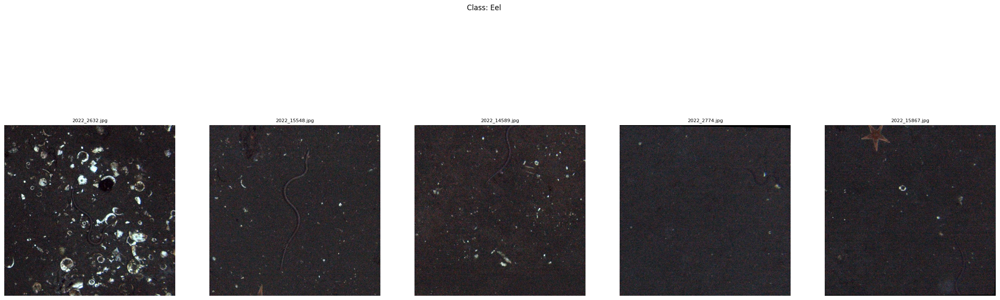

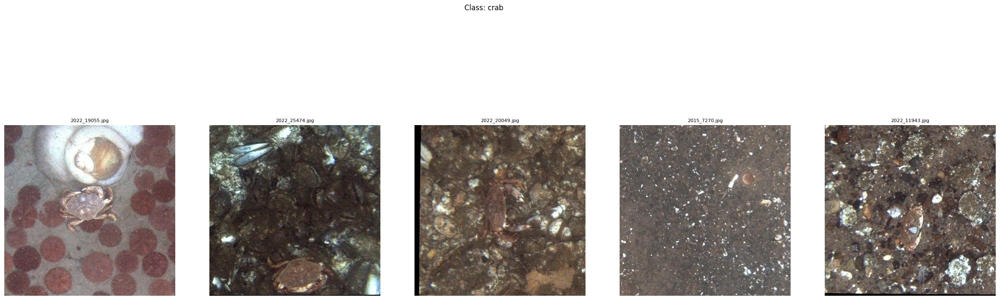

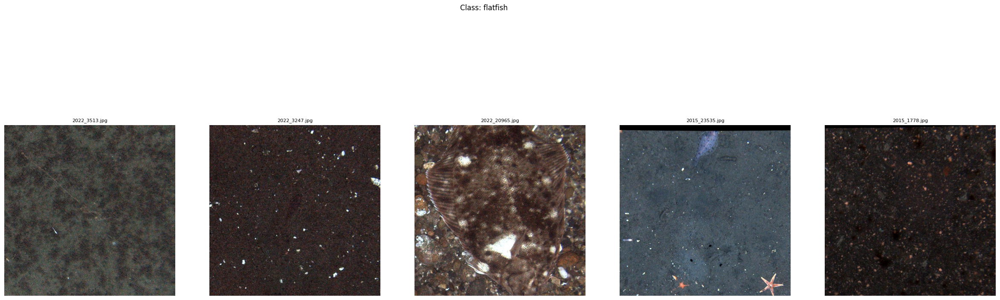

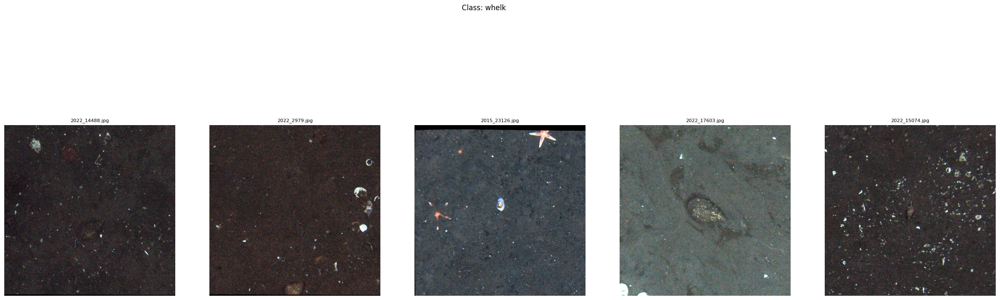

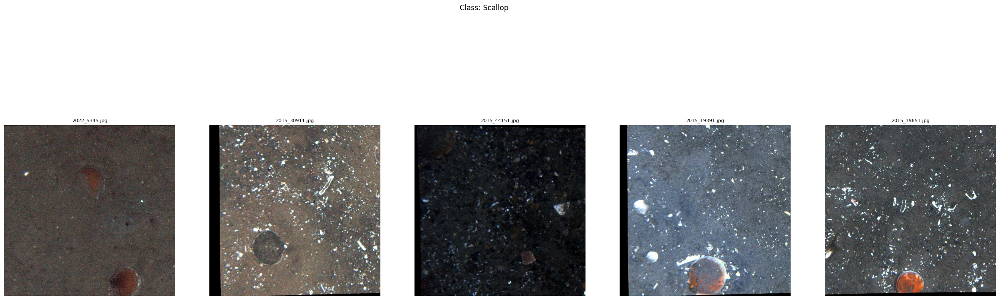

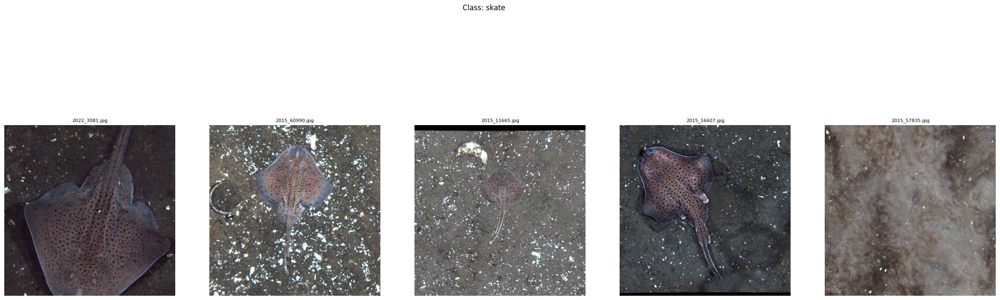

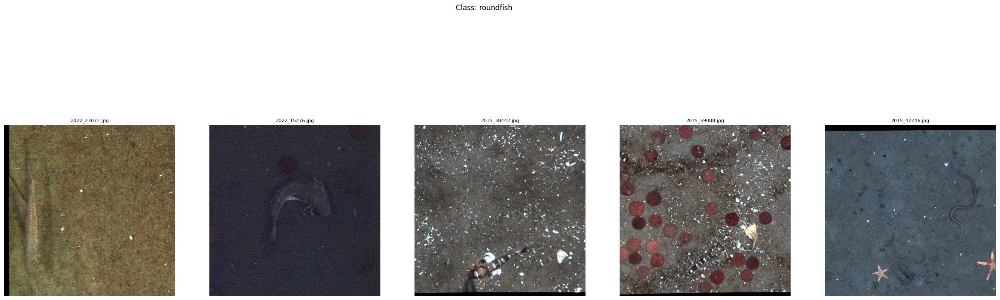

In [17]:
import matplotlib.pyplot as plt
import random
from PIL import Image

def show_random_samples(df, label_col='label', img_col='filename', image_folder='classification_dataset/images', samples_per_class=5):
    classes = df[label_col].unique()
    for cls in classes:
        subset = df[df[label_col] == cls]
        # Prepend folder path to filenames
        sample_paths = random.sample(list(subset[img_col]), min(samples_per_class, len(subset)))
        sample_paths = [os.path.join(image_folder, f) for f in sample_paths]

        fig, axes = plt.subplots(1, len(sample_paths), figsize=(30, 10))
        fig.suptitle(f"Class: {cls}")
        for ax, path in zip(axes, sample_paths):
            ax.imshow(Image.open(path))
            ax.axis('off')
            ax.set_title(os.path.basename(path), fontsize=8)
        plt.show()

# Example usage
show_random_samples(train_df, label_col='label', img_col='filename', image_folder='classification_dataset/images', samples_per_class=5)



In [19]:
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import torch
import torchvision.transforms as transforms

class BenthicDataset(Dataset):
    def __init__(self, df, img_dir, transform=None):
        self.df = df
        self.img_dir = img_dir
        self.transform = transform
        self.label_to_idx = {label: idx for idx, label in enumerate(sorted(df['label'].unique()))}

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.df.iloc[idx, 0])
        image = Image.open(img_path).convert("RGB")
        label = self.label_to_idx[self.df.iloc[idx, 1]]

        if self.transform:
            image = self.transform(image)
        return image, label
train_transforms = transforms.Compose([
    transforms.Resize((384, 384)),          # resize to model input
    transforms.RandomHorizontalFlip(),      # augment: horizontal flips
    transforms.RandomVerticalFlip(),        # optional: vertical flips
    transforms.ColorJitter(                  # optional: small color adjustments
        brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1
    ),
    transforms.ToTensor(),                  # convert PIL image to tensor
    transforms.Normalize(                   # normalize with ImageNet stats
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    ),
])

val_transforms = transforms.Compose([
    transforms.Resize((384, 384)),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    ),
])

train_dataset = BenthicDataset(
    train_df,
    os.path.join('classification_dataset', 'images'),
    transform=train_transforms  # use train_transforms here
)

val_dataset = BenthicDataset(
    val_df,
    os.path.join('classification_dataset', 'images'),
    transform=val_transforms  # use val_transforms here
)


train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=2)


In [8]:
CLASSES = [k for k,v in sorted(train_dataset.label_to_idx.items(), key=lambda x:x[1])]
CLASSES

['Eel', 'Scallop', 'crab', 'flatfish', 'roundfish', 'skate', 'whelk']

## Model Setup & Training

In [20]:
import torch
import torch.nn as nn
import torchvision.models as models

# Load pretrained EfficientNet
model = models.efficientnet_v2_s(pretrained=True)

# Replace the classification head
num_features = model.classifier[1].in_features
model.classifier[1] = nn.Linear(num_features, 7)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_V2_S_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_V2_S_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/efficientnet_v2_s-dd5fe13b.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_v2_s-dd5fe13b.pth


100%|██████████| 82.7M/82.7M [00:00<00:00, 211MB/s]


In [21]:
loss_fn = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-4)

for param in model.features.parameters():
    param.requires_grad = True

num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    for i, (images, labels) in enumerate(train_loader):
        images, labels = images.to(device), labels.to(device)

        # Forward pass
        outputs = model(images)
        loss = loss_fn(outputs, labels)

        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        if (i+1) % 50 == 0:
            print(f'Epoch [{epoch+1}/{num_epochs}], Step [{i+1}/{len(train_loader)}], Loss: {loss.item():.4f}')


Epoch [1/10], Step [50/263], Loss: 1.1191
Epoch [1/10], Step [100/263], Loss: 0.7000
Epoch [1/10], Step [150/263], Loss: 0.5428
Epoch [1/10], Step [200/263], Loss: 0.7186
Epoch [1/10], Step [250/263], Loss: 0.4457
Epoch [2/10], Step [50/263], Loss: 0.4519
Epoch [2/10], Step [100/263], Loss: 0.2735
Epoch [2/10], Step [150/263], Loss: 0.3449
Epoch [2/10], Step [200/263], Loss: 0.1487
Epoch [2/10], Step [250/263], Loss: 0.1126
Epoch [3/10], Step [50/263], Loss: 0.1988
Epoch [3/10], Step [100/263], Loss: 0.1614
Epoch [3/10], Step [150/263], Loss: 0.2961
Epoch [3/10], Step [200/263], Loss: 0.1877
Epoch [3/10], Step [250/263], Loss: 0.3257
Epoch [4/10], Step [50/263], Loss: 0.1820
Epoch [4/10], Step [100/263], Loss: 0.1837
Epoch [4/10], Step [150/263], Loss: 0.2441
Epoch [4/10], Step [200/263], Loss: 0.0918
Epoch [4/10], Step [250/263], Loss: 0.0493
Epoch [5/10], Step [50/263], Loss: 0.1559
Epoch [5/10], Step [100/263], Loss: 0.0470
Epoch [5/10], Step [150/263], Loss: 0.0629
Epoch [5/10], St

## Evaluation

In [22]:
model.eval()
correct = 0
total = 0

with torch.no_grad():  # disables gradient computation
    for images, labels in val_loader:  # or test_loader
        images, labels = images.to(device), labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs, 1)  # predicted class index
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

# Compute and print accuracy after all batches
accuracy = 100 * correct / total
print(f'Validation Accuracy: {accuracy:.2f}%')

Validation Accuracy: 94.33%


In [24]:
torch.save(model.state_dict(), "classification_model.pth")

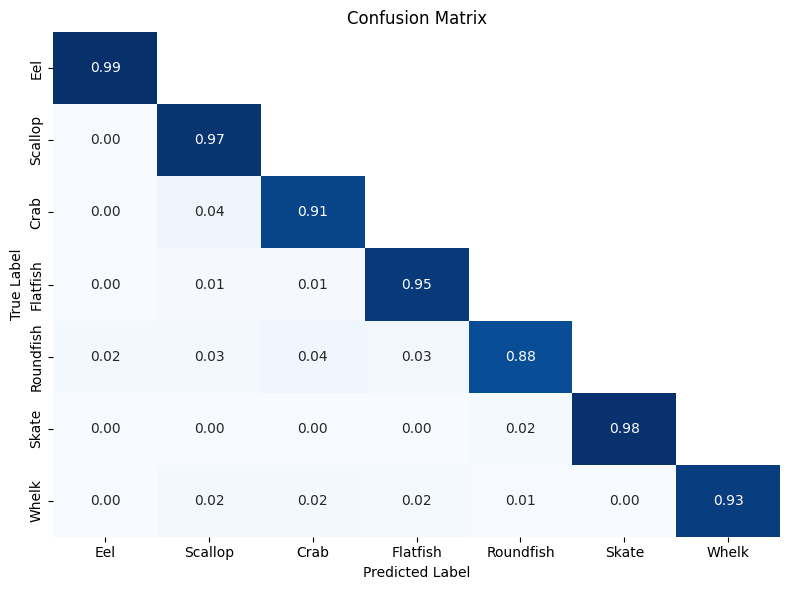

              precision    recall  f1-score   support

         Eel       0.98      0.99      0.98       300
     Scallop       0.90      0.97      0.93       300
        Crab       0.92      0.91      0.91       300
    Flatfish       0.93      0.95      0.94       300
   Roundfish       0.94      0.88      0.91       300
       Skate       0.98      0.98      0.98       300
       Whelk       0.96      0.93      0.95       300

    accuracy                           0.94      2100
   macro avg       0.94      0.94      0.94      2100
weighted avg       0.94      0.94      0.94      2100



In [23]:
import torch
import torch.nn.functional as F
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Put model in evaluation mode
model.eval()

all_preds = []
all_labels = []

with torch.no_grad():
    for images, labels in val_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = model(images)
        preds = torch.argmax(F.softmax(outputs, dim=1), dim=1)
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert to numpy arrays
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# Assuming you already have all_preds, all_labels, and train_dataset
all_preds = np.array(all_preds)
all_labels = np.array(all_labels)

# Compute confusion matrix
cm = confusion_matrix(all_labels, all_preds)
classes = [cls.capitalize() for cls in train_dataset.label_to_idx.keys()]

# Normalize confusion matrix by true labels
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

# Create mask for upper triangle
mask = np.triu(np.ones_like(cm_normalized, dtype=bool), k=1)

# Plot lower-triangle-only heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(
    cm_normalized,
    mask=mask,              # hide upper triangle
    annot=True,
    fmt=".2f",
    cmap="Blues",
    xticklabels=classes,
    yticklabels=classes,
    cbar=False              # optional: remove color bar
)

# Remove excess tick labels (upper-triangle side)
for i in range(len(classes)):
    for j in range(len(classes)):
        if mask[i, j]:
            plt.text(j + 0.5, i + 0.5, "", ha="center", va="center")

plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.tight_layout()
plt.show()


# Print detailed classification report
print(classification_report(all_labels, all_preds, target_names=classes))


In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
all_preds = np.array(all_preds)
all_labels = np.array(all_labels)

# Compute confusion matrix
cm = confusion_matrix(all_labels, all_preds)
classes = list(train_dataset.label_to_idx.keys())

# Normalize confusion matrix by true labels
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

# Create mask for upper triangle
mask = np.triu(np.ones_like(cm_normalized, dtype=bool))

# Plot lower-triangle-only heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(
    cm_normalized,
    mask=mask,              # hide upper triangle
    annot=True,
    fmt=".2f",
    cmap="Blues",
    xticklabels=classes,
    yticklabels=classes,
    cbar=False              # optional: remove color bar
)

# Remove excess tick labels (upper-triangle side)
for i in range(len(classes)):
    for j in range(len(classes)):
        if mask[i, j]:
            plt.text(j + 0.5, i + 0.5, "", ha="center", va="center")

plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Normalized Confusion Matrix (Lower Triangle)")
plt.tight_layout()
plt.show()


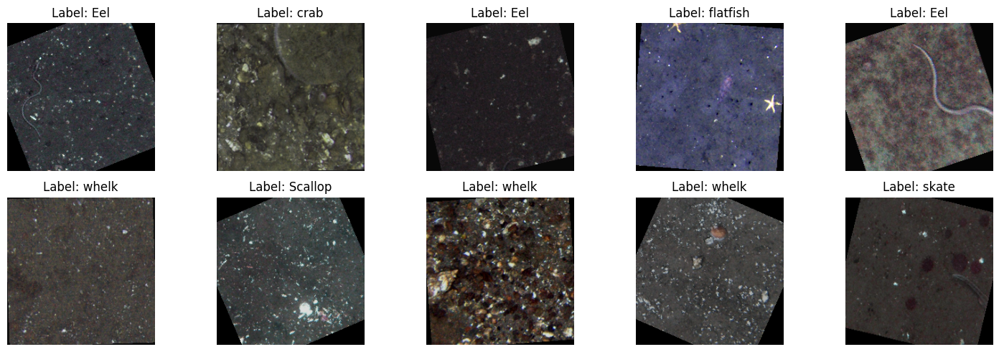

In [27]:
num_images = 10
CLASSES = ['Eel', 'Scallop', 'crab', 'flatfish', 'roundfish', 'skate', 'whelk']
plt.figure(figsize=(15, 5))

for i in range(num_images):
    # Get image and label from dataset
    img, label_idx = train_dataset[i]

    # If transforms include normalization, undo it for display
    if hasattr(train_dataset, 'transform') and train_dataset.transform is not None:
        # Assuming the transform is composed of ToTensor and Normalize
        img_disp = img.clone()
        if isinstance(img_disp, torch.Tensor):
            mean = torch.tensor([0.485, 0.456, 0.406]).view(3,1,1)
            std = torch.tensor([0.229, 0.224, 0.225]).view(3,1,1)
            img_disp = img_disp * std + mean
            img_disp = img_disp.clamp(0, 1)
            img_disp = img_disp.permute(1, 2, 0).numpy()

    else:
        img_disp = img

    plt.subplot(2, 5, i+1)
    plt.imshow(img_disp)
    plt.title(f"Label: {CLASSES[label_idx]}")
    plt.axis('off')

plt.tight_layout()
plt.show()